<a href="https://colab.research.google.com/github/White-Wolf99/Differential-Drive-Robot-Model/blob/main/495_HW1_Prb3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML, display

In [ ]:
# Given parameters
t_end = 10  # Simulation time
dt_values = [0.1, 0.5, 0.01]  # Different time steps
r = 0.1  # Wheel radius
L = 1.0  # Distance between wheels


In [ ]:

# Control input function for omega_R and omega_L
def omega_L_control(t):
    if 4 <= t <= 6:
        return 12
    elif 6 <= t <= 8:
        return 12
    else:
        return 1

def omega_R_control(t):
    if 0.5 <= t <= 1.5:
        return 12
    elif 2 <= t <= 4:
        return 12
    else:
        return 1


In [ ]:

# Function to simulate the differential drive robot using Euler's method
def simulate_differential_drive(dt):
    t_values = np.arange(0, t_end + dt, dt)  # Time steps
    x = np.zeros_like(t_values)
    y = np.zeros_like(t_values)
    theta = np.zeros_like(t_values)

    # Initial conditions
    x[0] = 0
    y[0] = 0
    theta[0] = 1  # Given initial angle

    # Euler integration
    for k in range(len(t_values) - 1):
        omega_R = omega_R_control(t_values[k])
        omega_L = omega_L_control(t_values[k])

        v_R = r * omega_R
        v_L = r * omega_L
        v = (v_R + v_L) / 2  # Robot center velocity
        omega = (v_R - v_L) / L  # Angular velocity

        x[k+1] = x[k] + dt * v * np.cos(theta[k])
        y[k+1] = y[k] + dt * v * np.sin(theta[k])
        theta[k+1] = theta[k] + dt * omega

    return t_values, x, y, theta


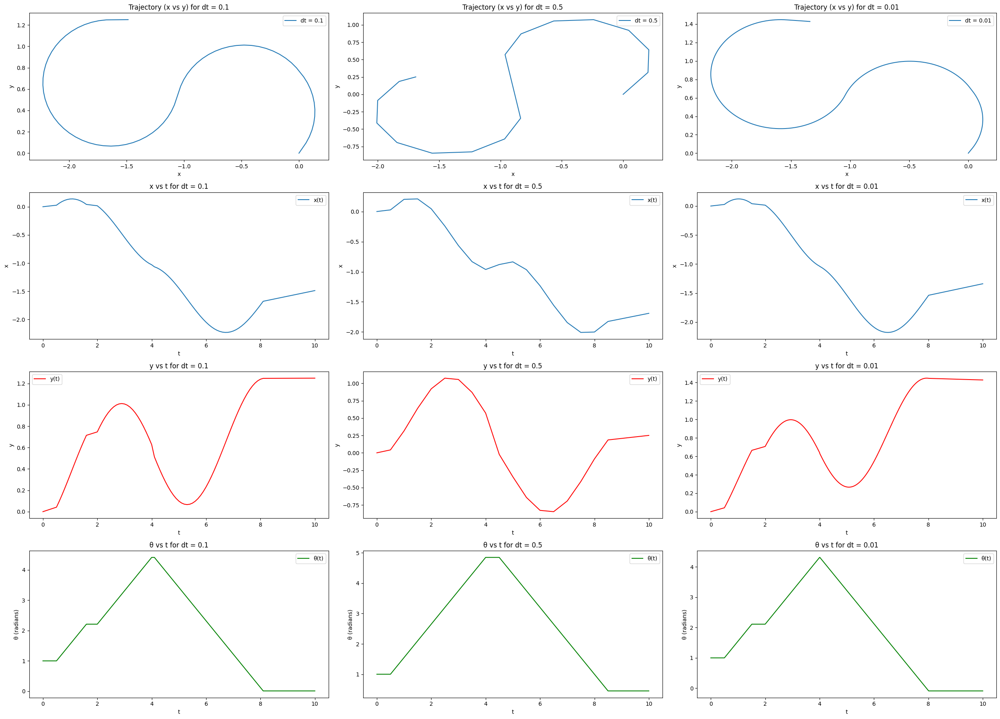

In [ ]:

# Run simulations for different time steps and plot results
fig, axes = plt.subplots(4, len(dt_values), figsize=(25, 18))

for i, dt in enumerate(dt_values):
    t_vals, x_vals, y_vals, theta_vals = simulate_differential_drive(dt)

    # Plot x vs y (Trajectory)
    axes[0, i].plot(x_vals, y_vals, label=f"dt = {dt}")
    axes[0, i].set_xlabel("x")
    axes[0, i].set_ylabel("y")
    axes[0, i].set_title(f"Trajectory (x vs y) for dt = {dt}")
    axes[0, i].legend()

    # Plot x vs t
    axes[1, i].plot(t_vals, x_vals, label="x(t)")
    axes[1, i].set_xlabel("t")
    axes[1, i].set_ylabel("x")
    axes[1, i].set_title(f"x vs t for dt = {dt}")
    axes[1, i].legend()

    # Plot y vs t
    axes[2, i].plot(t_vals, y_vals, label="y(t)", color='r')
    axes[2, i].set_xlabel("t")
    axes[2, i].set_ylabel("y")
    axes[2, i].set_title(f"y vs t for dt = {dt}")
    axes[2, i].legend()

    # Plot theta vs t
    axes[3, i].plot(t_vals, theta_vals, label="θ(t)", color='g')
    axes[3, i].set_xlabel("t")
    axes[3, i].set_ylabel("θ (radians)")
    axes[3, i].set_title(f"θ vs t for dt = {dt}")
    axes[3, i].legend()

plt.tight_layout()
plt.show()

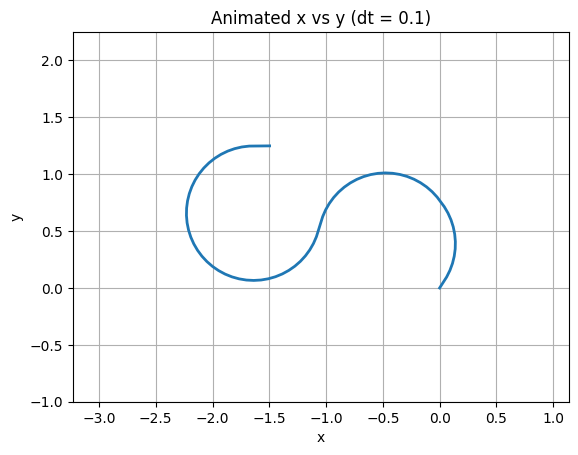

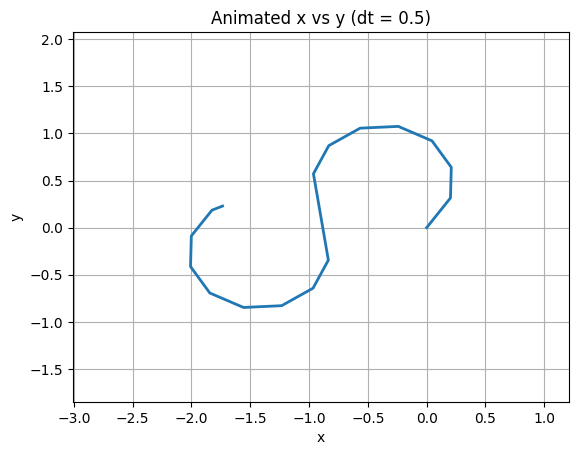

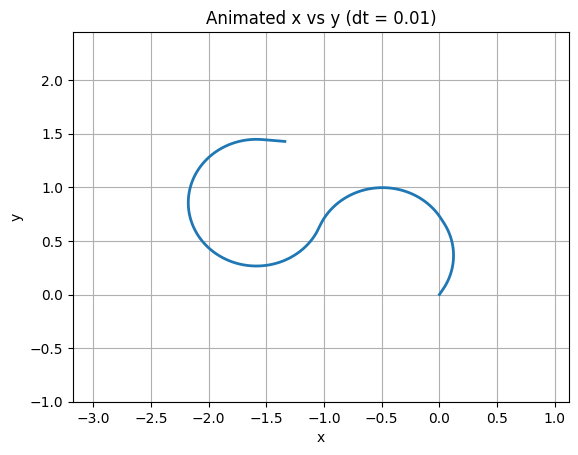

In [ ]:
# Animations for different dt values
for dt in dt_values:
    t_vals, x_vals, y_vals, _ = simulate_differential_drive(dt)


    # Animation setup
    fig, ax = plt.subplots()
    ax.set_xlim(np.min(x_vals) - 1, np.max(x_vals) + 1)
    ax.set_ylim(np.min(y_vals) - 1, np.max(y_vals) + 1)
    ax.set_xlabel('x')
    ax.set_ylabel('y')
    ax.set_title(f'Animated x vs y (dt = {dt})')
    plt.grid()

    line, = ax.plot([], [], lw=2)

    def init():
        line.set_data([], [])
        return line,

    def animate(frame):
        xarr = x_vals[:frame]
        yarr = y_vals[:frame]
        line.set_data(xarr, yarr)
        return line,

    ani = FuncAnimation(fig, animate, frames=len(t_vals), init_func=init, blit=True, interval=50)

    # Display the animation
    display(HTML(ani.to_jshtml()))
